# Dubai Satellite Imagery Semantic Segmentation
Humans in the Loop has published an open access dataset annotated for a joint project with the Mohammed Bin Rashid Space Center in Dubai, the UAE. 

The dataset consists of aerial imagery of Dubai obtained by MBRSC satellites and annotated with pixel-wise semantic segmentation in 6 classes. The images were segmented by the trainees of the Roia Foundation in Syria.

Original Dataset Link: https://humansintheloop.org/resources/datasets/semantic-segmentation-dataset/

# Installing & Importing Libraries

In [1]:
import pickle
import numpy as np
from PIL import Image
#import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

2023-02-22 13:32:58.440140: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
"""
label_codes = [(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)]"""
label_codes = [(60, 16, 152),
  (60, 16, 152),
  (110, 193, 228),
  (60, 16, 152),
  (226, 169, 41),
  (60, 16, 152)]
label_names = ['Building', 'Land', 'Road', 'Vegetation', 'Water', 'Unlabeled']

In [3]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [4]:
id2code

{0: (60, 16, 152),
 1: (60, 16, 152),
 2: (110, 193, 228),
 3: (60, 16, 152),
 4: (226, 169, 41),
 5: (60, 16, 152)}

In [5]:
id2name

{0: 'Building',
 1: 'Land',
 2: 'Road',
 3: 'Vegetation',
 4: 'Water',
 5: 'Unlabeled'}

# Define Functions for One Hot Encoding RGB Labels & Decoding Encoded Predictions

In [6]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs: 
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs: 
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3) 
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

## InceptionResNetV2 UNet

In [7]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_inception_resnetv2_unet(input_shape):
    """ Input """
    inputs = Input(input_shape)

    """ Pre-trained InceptionResNetV2 Model """
    encoder = InceptionResNetV2(include_top=False, weights="imagenet", input_tensor=inputs)

    """ Encoder """
    s1 = encoder.get_layer("input_1").output           ## (512 x 512)

    s2 = encoder.get_layer("activation").output        ## (255 x 255)
    s2 = ZeroPadding2D(( (1, 0), (1, 0) ))(s2)         ## (256 x 256)

    s3 = encoder.get_layer("activation_3").output      ## (126 x 126)
    s3 = ZeroPadding2D((1, 1))(s3)                     ## (128 x 128)

    s4 = encoder.get_layer("activation_74").output      ## (61 x 61)
    s4 = ZeroPadding2D(( (2, 1),(2, 1) ))(s4)           ## (64 x 64)

    """ Bridge """
    b1 = encoder.get_layer("activation_161").output     ## (30 x 30)
    b1 = ZeroPadding2D((1, 1))(b1)                      ## (32 x 32)

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)                     ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                     ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                     ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                      ## (512 x 512)
    
    """ Output """
    dropout = Dropout(0.3)(d4)
    outputs = Conv2D(6, 1, padding="same", activation="softmax")(dropout)

    model = Model(inputs, outputs, name="InceptionResNetV2-UNet")
    return model

In [8]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_inception_resnetv2_unet(input_shape = (512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

2023-02-22 13:33:07.072060: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-22 13:33:07.169563: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-22 13:33:07.169744: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-22 13:33:07.170307: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operation

Model: "InceptionResNetV2-UNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 255, 255, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 255, 255, 32  96         ['conv2d[0][0]']                 
 alization)                     )                                            

                                                                                                  
 conv2d_10 (Conv2D)             (None, 61, 61, 96)   82944       ['activation_9[0][0]']           
                                                                                                  
 conv2d_11 (Conv2D)             (None, 61, 61, 64)   12288       ['average_pooling2d[0][0]']      
                                                                                                  
 batch_normalization_5 (BatchNo  (None, 61, 61, 96)  288         ['conv2d_5[0][0]']               
 rmalization)                                                                                     
                                                                                                  
 batch_normalization_7 (BatchNo  (None, 61, 61, 64)  192         ['conv2d_7[0][0]']               
 rmalization)                                                                                     
          

 conv2d_21 (Conv2D)             (None, 61, 61, 32)   10240       ['block35_1_ac[0][0]']           
                                                                                                  
 batch_normalization_21 (BatchN  (None, 61, 61, 32)  96          ['conv2d_21[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_21 (Activation)     (None, 61, 61, 32)   0           ['batch_normalization_21[0][0]'] 
                                                                                                  
 conv2d_19 (Conv2D)             (None, 61, 61, 32)   10240       ['block35_1_ac[0][0]']           
                                                                                                  
 conv2d_22 (Conv2D)             (None, 61, 61, 48)   13824       ['activation_21[0][0]']          
          

 batch_normalization_26 (BatchN  (None, 61, 61, 32)  96          ['conv2d_26[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_29 (BatchN  (None, 61, 61, 64)  192         ['conv2d_29[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_24 (Activation)     (None, 61, 61, 32)   0           ['batch_normalization_24[0][0]'] 
                                                                                                  
 activation_26 (Activation)     (None, 61, 61, 32)   0           ['batch_normalization_26[0][0]'] 
                                                                                                  
 activatio

 conv2d_37 (Conv2D)             (None, 61, 61, 32)   10240       ['block35_4_ac[0][0]']           
                                                                                                  
 conv2d_40 (Conv2D)             (None, 61, 61, 48)   13824       ['activation_39[0][0]']          
                                                                                                  
 batch_normalization_37 (BatchN  (None, 61, 61, 32)  96          ['conv2d_37[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 batch_normalization_40 (BatchN  (None, 61, 61, 48)  144         ['conv2d_40[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activatio

                                                                                                  
 activation_44 (Activation)     (None, 61, 61, 32)   0           ['batch_normalization_44[0][0]'] 
                                                                                                  
 activation_47 (Activation)     (None, 61, 61, 64)   0           ['batch_normalization_47[0][0]'] 
                                                                                                  
 block35_6_mixed (Concatenate)  (None, 61, 61, 128)  0           ['activation_42[0][0]',          
                                                                  'activation_44[0][0]',          
                                                                  'activation_47[0][0]']          
                                                                                                  
 block35_6_conv (Conv2D)        (None, 61, 61, 320)  41280       ['block35_6_mixed[0][0]']        
          

 batch_normalization_58 (BatchN  (None, 61, 61, 48)  144         ['conv2d_58[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_55 (Activation)     (None, 61, 61, 32)   0           ['batch_normalization_55[0][0]'] 
                                                                                                  
 activation_58 (Activation)     (None, 61, 61, 48)   0           ['batch_normalization_58[0][0]'] 
                                                                                                  
 conv2d_54 (Conv2D)             (None, 61, 61, 32)   10240       ['block35_7_ac[0][0]']           
                                                                                                  
 conv2d_56 (Conv2D)             (None, 61, 61, 32)   9216        ['activation_55[0][0]']          
          

                                                                  'activation_65[0][0]']          
                                                                                                  
 block35_9_conv (Conv2D)        (None, 61, 61, 320)  41280       ['block35_9_mixed[0][0]']        
                                                                                                  
 block35_9 (Lambda)             (None, 61, 61, 320)  0           ['block35_8_ac[0][0]',           
                                                                  'block35_9_conv[0][0]']         
                                                                                                  
 block35_9_ac (Activation)      (None, 61, 61, 320)  0           ['block35_9[0][0]']              
                                                                                                  
 conv2d_69 (Conv2D)             (None, 61, 61, 32)   10240       ['block35_9_ac[0][0]']           
          

 batch_normalization_75 (BatchN  (None, 30, 30, 384)  1152       ['conv2d_75[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_72 (Activation)     (None, 30, 30, 384)  0           ['batch_normalization_72[0][0]'] 
                                                                                                  
 activation_75 (Activation)     (None, 30, 30, 384)  0           ['batch_normalization_75[0][0]'] 
                                                                                                  
 max_pooling2d_2 (MaxPooling2D)  (None, 30, 30, 320)  0          ['block35_10_ac[0][0]']          
                                                                                                  
 mixed_6a (Concatenate)         (None, 30, 30, 1088  0           ['activation_72[0][0]',          
          

                                                                                                  
 block17_2_conv (Conv2D)        (None, 30, 30, 1088  418880      ['block17_2_mixed[0][0]']        
                                )                                                                 
                                                                                                  
 block17_2 (Lambda)             (None, 30, 30, 1088  0           ['block17_1_ac[0][0]',           
                                )                                 'block17_2_conv[0][0]']         
                                                                                                  
 block17_2_ac (Activation)      (None, 30, 30, 1088  0           ['block17_2[0][0]']              
                                )                                                                 
                                                                                                  
 conv2d_85

                                                                                                  
 block17_4 (Lambda)             (None, 30, 30, 1088  0           ['block17_3_ac[0][0]',           
                                )                                 'block17_4_conv[0][0]']         
                                                                                                  
 block17_4_ac (Activation)      (None, 30, 30, 1088  0           ['block17_4[0][0]']              
                                )                                                                 
                                                                                                  
 conv2d_93 (Conv2D)             (None, 30, 30, 128)  139264      ['block17_4_ac[0][0]']           
                                                                                                  
 batch_normalization_93 (BatchN  (None, 30, 30, 128)  384        ['conv2d_93[0][0]']              
 ormalizat

                                                                                                  
 block17_6_ac (Activation)      (None, 30, 30, 1088  0           ['block17_6[0][0]']              
                                )                                                                 
                                                                                                  
 conv2d_101 (Conv2D)            (None, 30, 30, 128)  139264      ['block17_6_ac[0][0]']           
                                                                                                  
 batch_normalization_101 (Batch  (None, 30, 30, 128)  384        ['conv2d_101[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_101 (Activation)    (None, 30, 30, 128)  0           ['batch_normalization_101[0][0]']
          

                                                                                                  
 conv2d_109 (Conv2D)            (None, 30, 30, 128)  139264      ['block17_8_ac[0][0]']           
                                                                                                  
 batch_normalization_109 (Batch  (None, 30, 30, 128)  384        ['conv2d_109[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_109 (Activation)    (None, 30, 30, 128)  0           ['batch_normalization_109[0][0]']
                                                                                                  
 conv2d_110 (Conv2D)            (None, 30, 30, 160)  143360      ['activation_109[0][0]']         
                                                                                                  
 batch_nor

 batch_normalization_117 (Batch  (None, 30, 30, 128)  384        ['conv2d_117[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_117 (Activation)    (None, 30, 30, 128)  0           ['batch_normalization_117[0][0]']
                                                                                                  
 conv2d_118 (Conv2D)            (None, 30, 30, 160)  143360      ['activation_117[0][0]']         
                                                                                                  
 batch_normalization_118 (Batch  (None, 30, 30, 160)  480        ['conv2d_118[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activatio

 activation_125 (Activation)    (None, 30, 30, 128)  0           ['batch_normalization_125[0][0]']
                                                                                                  
 conv2d_126 (Conv2D)            (None, 30, 30, 160)  143360      ['activation_125[0][0]']         
                                                                                                  
 batch_normalization_126 (Batch  (None, 30, 30, 160)  480        ['conv2d_126[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_126 (Activation)    (None, 30, 30, 160)  0           ['batch_normalization_126[0][0]']
                                                                                                  
 conv2d_124 (Conv2D)            (None, 30, 30, 192)  208896      ['block17_12_ac[0][0]']          
          

                                                                                                  
 batch_normalization_134 (Batch  (None, 30, 30, 160)  480        ['conv2d_134[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_134 (Activation)    (None, 30, 30, 160)  0           ['batch_normalization_134[0][0]']
                                                                                                  
 conv2d_132 (Conv2D)            (None, 30, 30, 192)  208896      ['block17_14_ac[0][0]']          
                                                                                                  
 conv2d_135 (Conv2D)            (None, 30, 30, 192)  215040      ['activation_134[0][0]']         
                                                                                                  
 batch_nor

                                                                                                  
 activation_142 (Activation)    (None, 30, 30, 160)  0           ['batch_normalization_142[0][0]']
                                                                                                  
 conv2d_140 (Conv2D)            (None, 30, 30, 192)  208896      ['block17_16_ac[0][0]']          
                                                                                                  
 conv2d_143 (Conv2D)            (None, 30, 30, 192)  215040      ['activation_142[0][0]']         
                                                                                                  
 batch_normalization_140 (Batch  (None, 30, 30, 192)  576        ['conv2d_140[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_nor

 conv2d_148 (Conv2D)            (None, 30, 30, 192)  208896      ['block17_18_ac[0][0]']          
                                                                                                  
 conv2d_151 (Conv2D)            (None, 30, 30, 192)  215040      ['activation_150[0][0]']         
                                                                                                  
 batch_normalization_148 (Batch  (None, 30, 30, 192)  576        ['conv2d_148[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_151 (Batch  (None, 30, 30, 192)  576        ['conv2d_151[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activatio

 conv2d_transpose (Conv2DTransp  (None, 64, 64, 512)  590336     ['zero_padding2d_3[0][0]']       
 ose)                                                                                             
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 64, 64, 256)  0          ['activation_74[0][0]']          
 D)                                                                                               
                                                                                                  
 concatenate (Concatenate)      (None, 64, 64, 768)  0           ['conv2d_transpose[0][0]',       
                                                                  'zero_padding2d_2[0][0]']       
                                                                                                  
 conv2d_203 (Conv2D)            (None, 64, 64, 512)  3539456     ['concatenate[0][0]']            
          

 conv2d_209 (Conv2D)            (None, 512, 512, 64  38656       ['concatenate_3[0][0]']          
                                )                                                                 
                                                                                                  
 batch_normalization_209 (Batch  (None, 512, 512, 64  256        ['conv2d_209[0][0]']             
 Normalization)                 )                                                                 
                                                                                                  
 activation_209 (Activation)    (None, 512, 512, 64  0           ['batch_normalization_209[0][0]']
                                )                                                                 
                                                                                                  
 conv2d_210 (Conv2D)            (None, 512, 512, 64  36928       ['activation_209[0][0]']         
          

In [9]:
#SVG(model_to_dot(model).create(prog='dot', format='svg'))
#plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

In [10]:
model.load_weights("./InceptionResNetV2-UNet.h5")

2023-02-22 13:33:41.318160: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8401
2023-02-22 13:33:42.341003: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-02-22 13:33:42.341481: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-02-22 13:33:42.341497: W tensorflow/compiler/xla/stream_executor/gpu/asm_compiler.cc:85] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2023-02-22 13:33:42.341889: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-02-22 13:33:42.341928: W tensorflow/compiler/xla/stream_executor/gpu/redzone_allocator.cc:318] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2023-02-22 13:33:43.898442:

1/1 [==============================] - 8s 8s/step


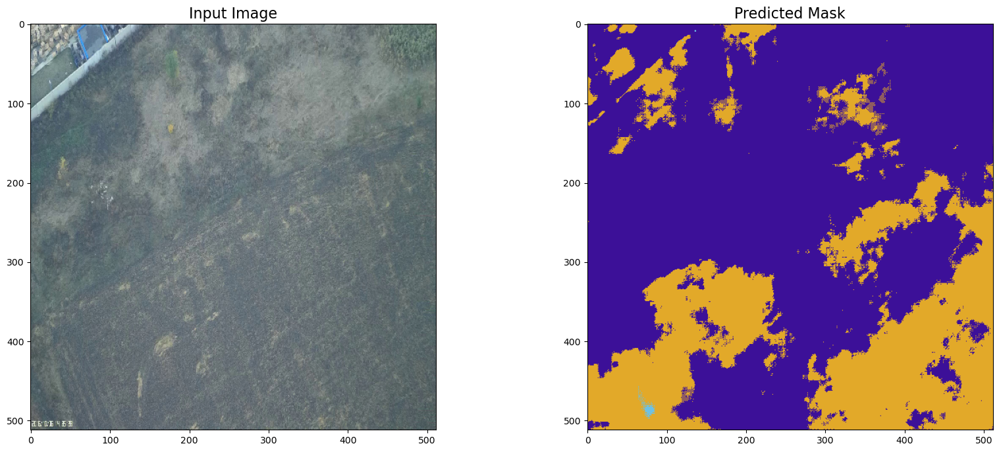

1/1 [==============================] - 0s 26ms/step


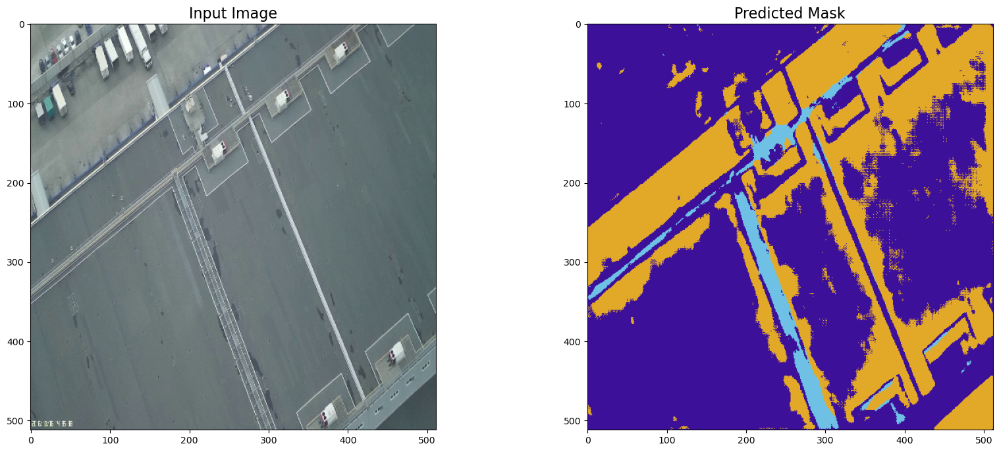

1/1 [==============================] - 0s 39ms/step


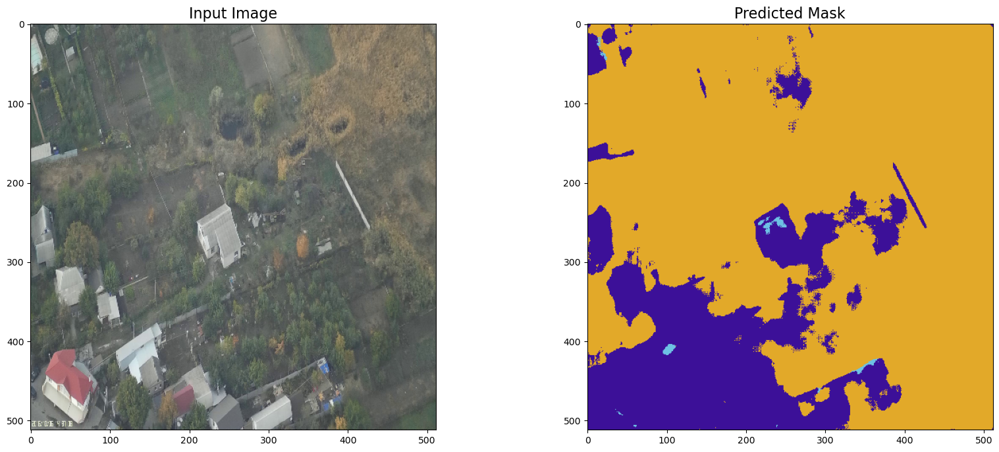

1/1 [==============================] - 0s 24ms/step


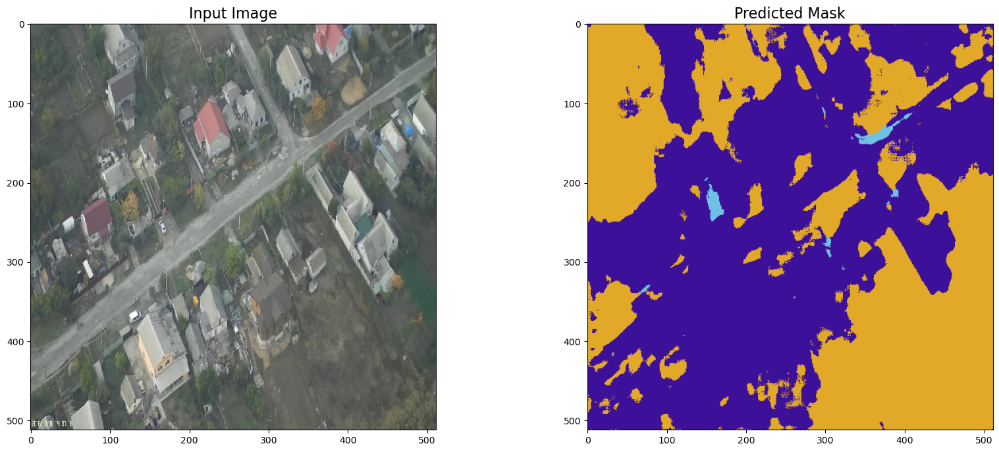

1/1 [==============================] - 0s 25ms/step


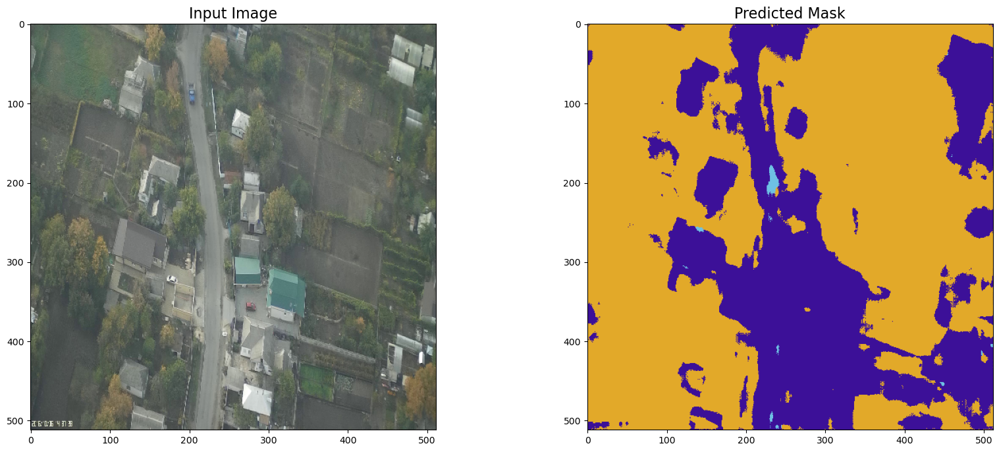

1/1 [==============================] - 0s 29ms/step


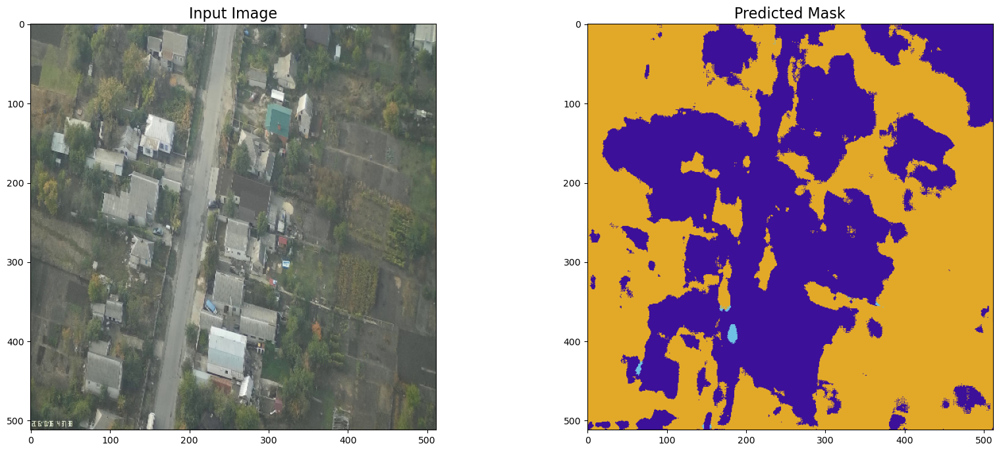

1/1 [==============================] - 0s 27ms/step


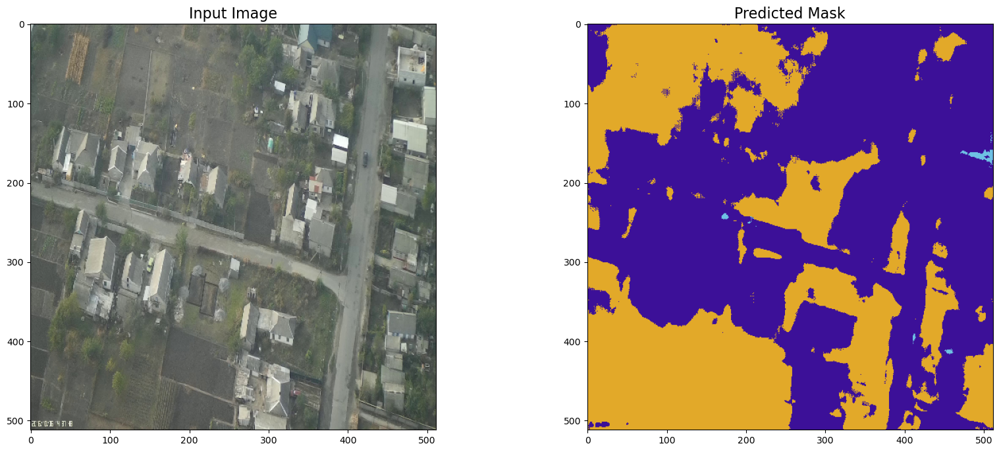

1/1 [==============================] - 0s 26ms/step


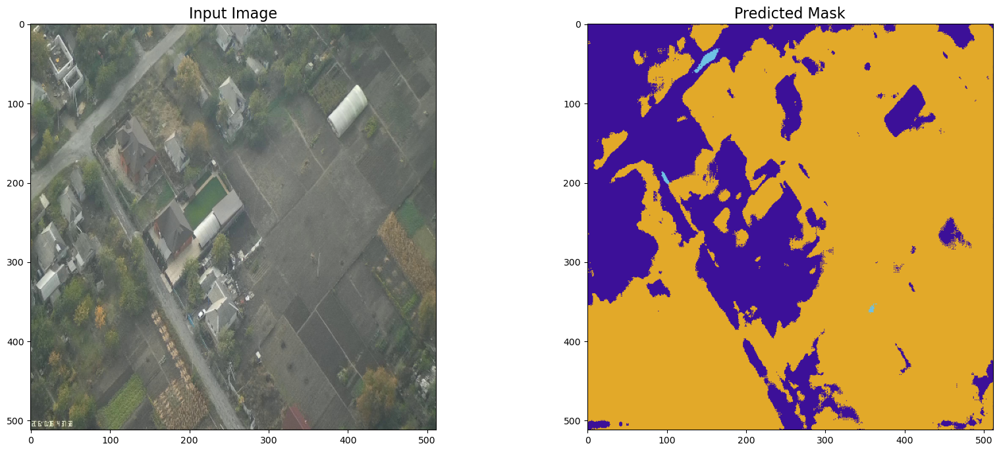

1/1 [==============================] - 0s 30ms/step


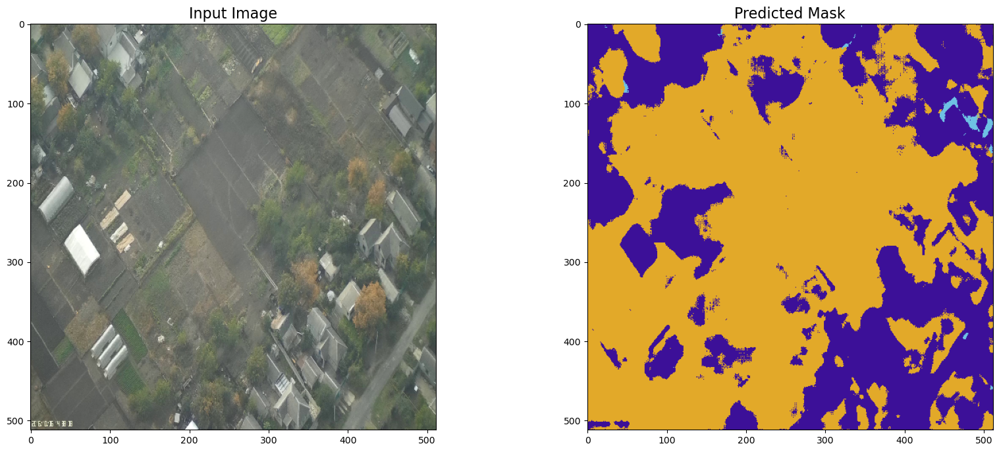

1/1 [==============================] - 0s 25ms/step


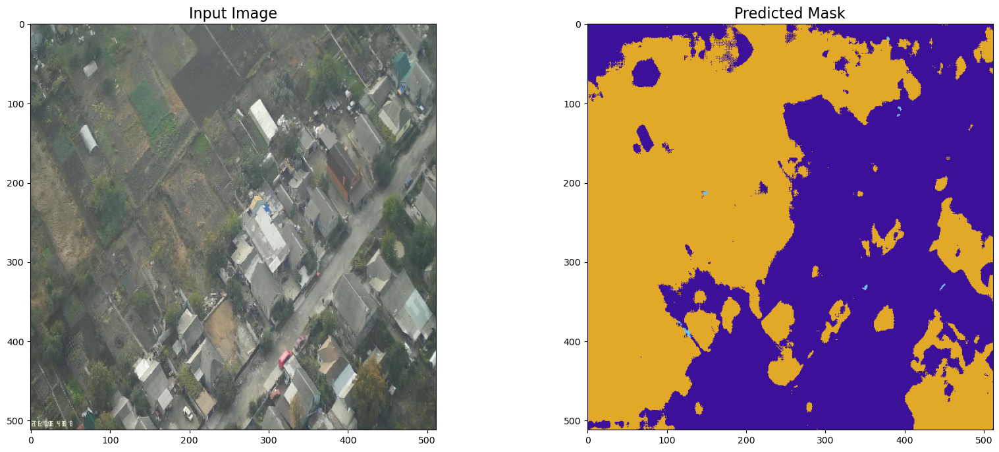

1/1 [==============================] - 0s 24ms/step


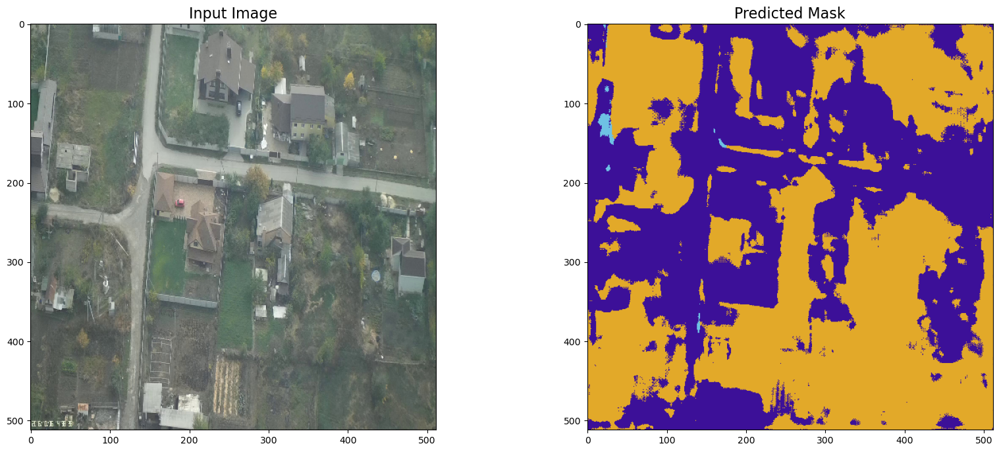

1/1 [==============================] - 0s 24ms/step


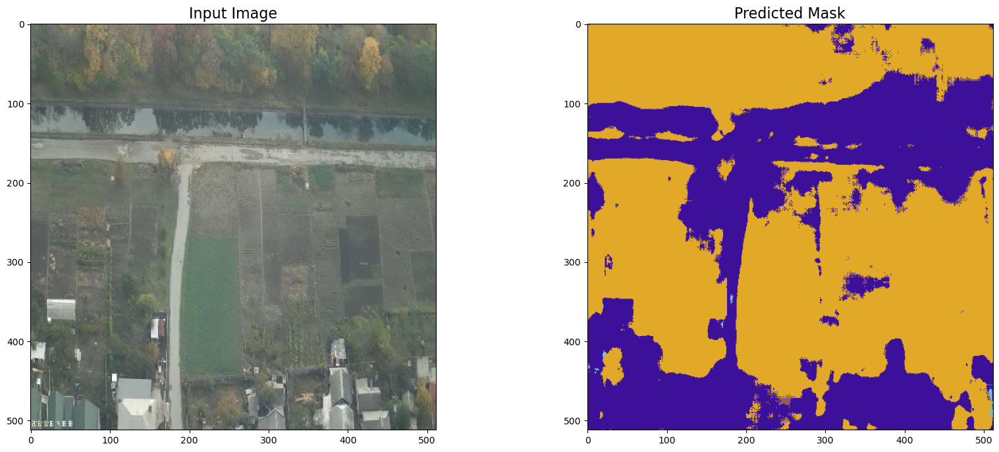

1/1 [==============================] - 0s 27ms/step


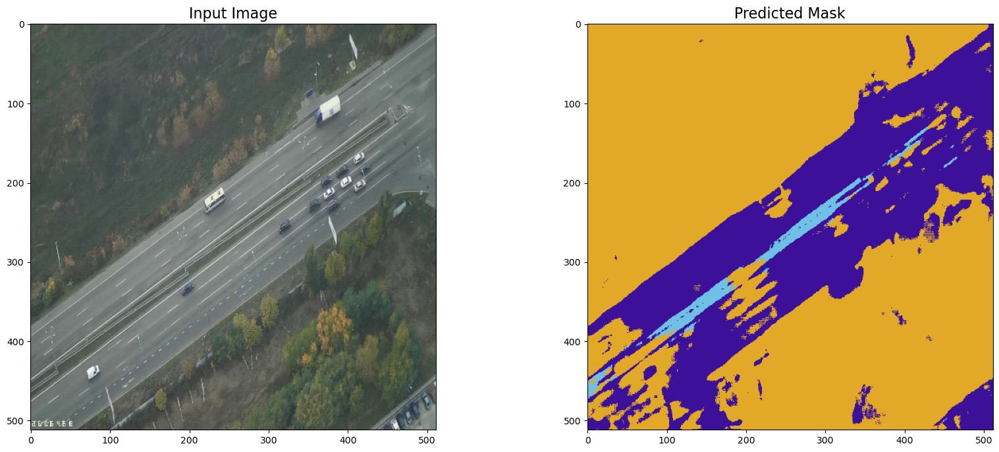

1/1 [==============================] - 0s 29ms/step


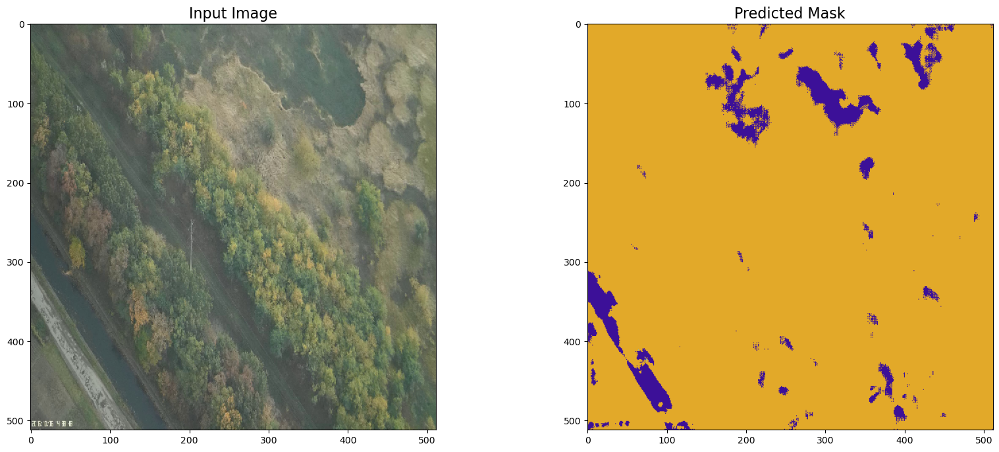

1/1 [==============================] - 0s 23ms/step


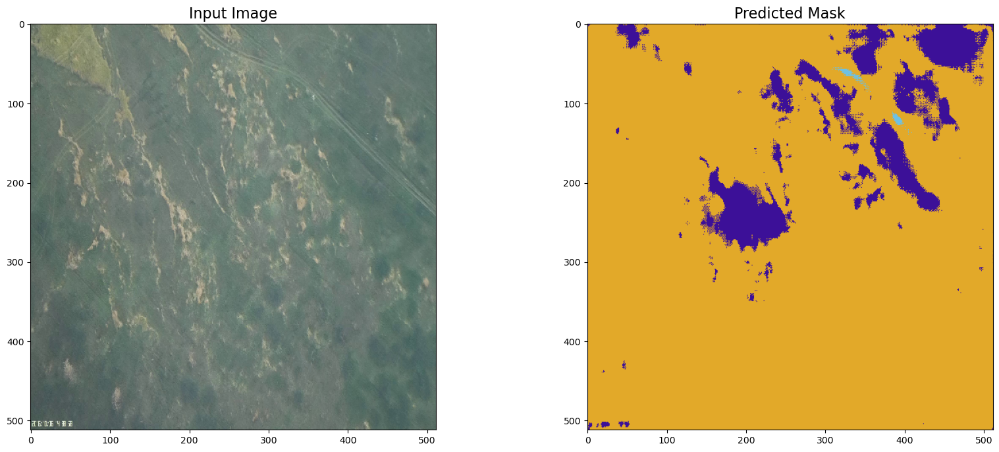

1/1 [==============================] - 0s 29ms/step


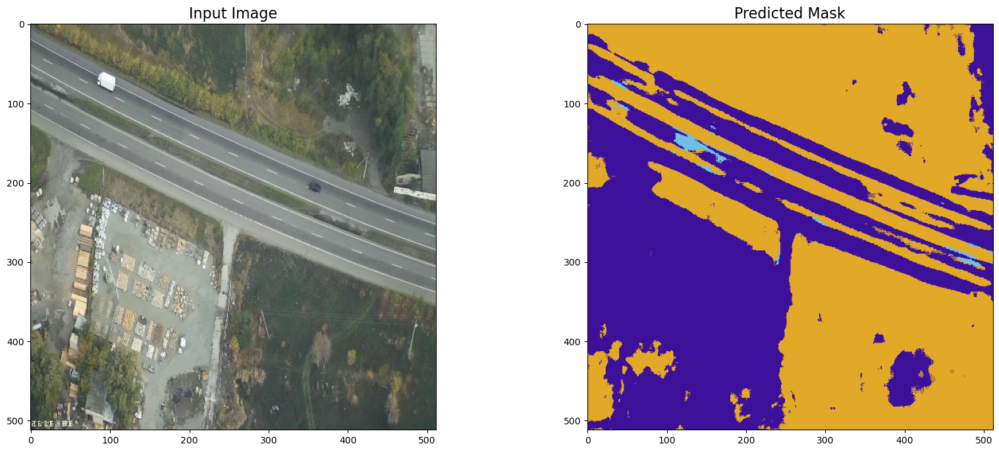

1/1 [==============================] - 0s 23ms/step


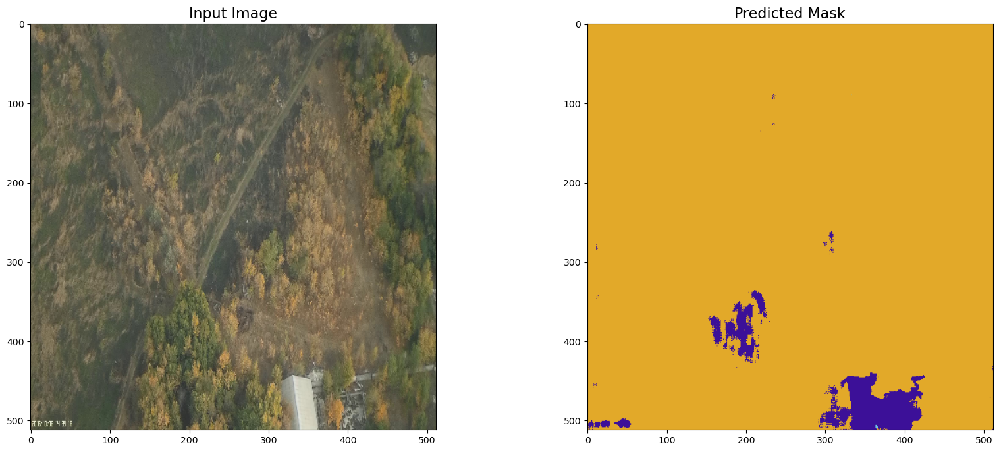

1/1 [==============================] - 0s 28ms/step


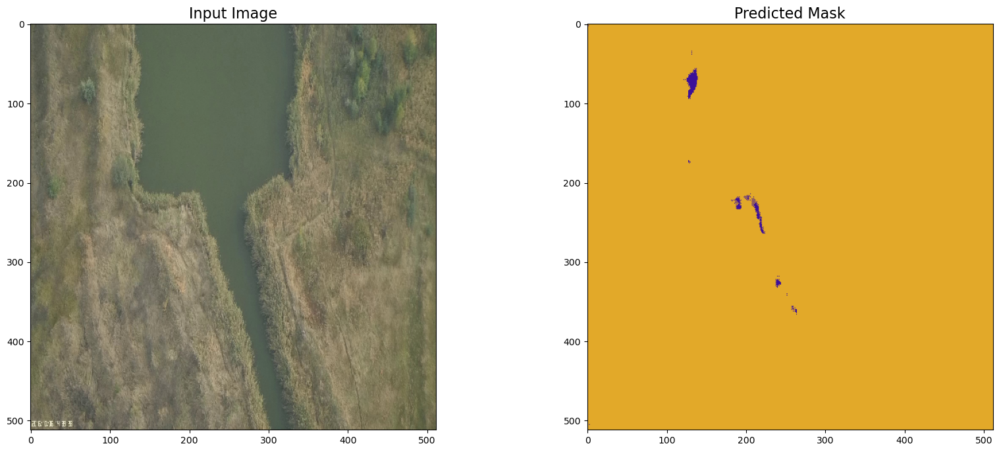

1/1 [==============================] - 0s 26ms/step


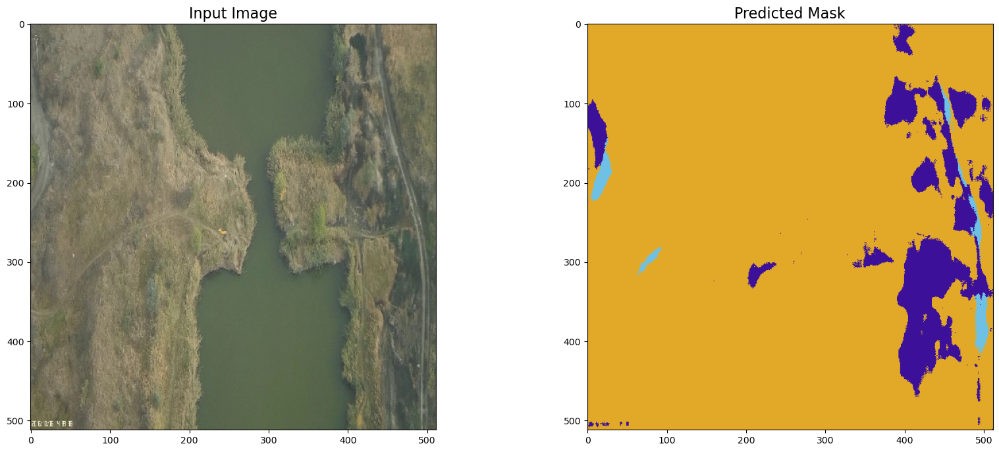

1/1 [==============================] - 0s 25ms/step


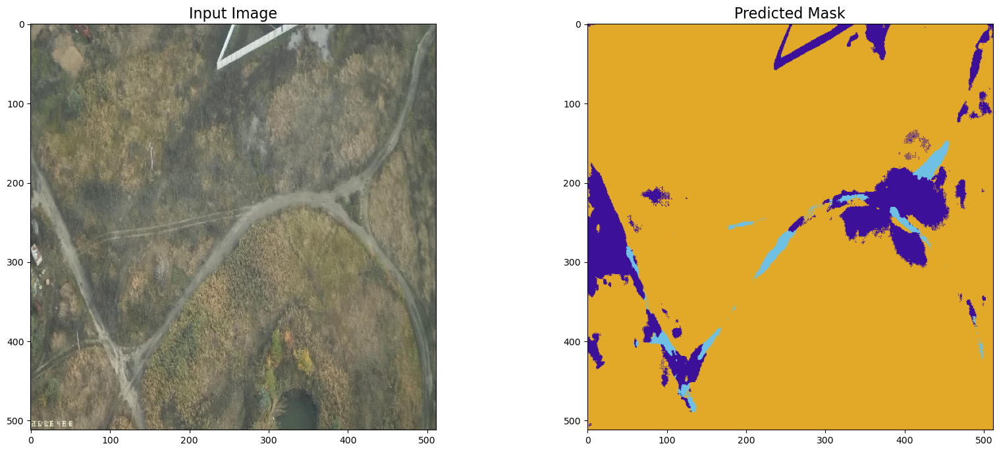

1/1 [==============================] - 0s 22ms/step


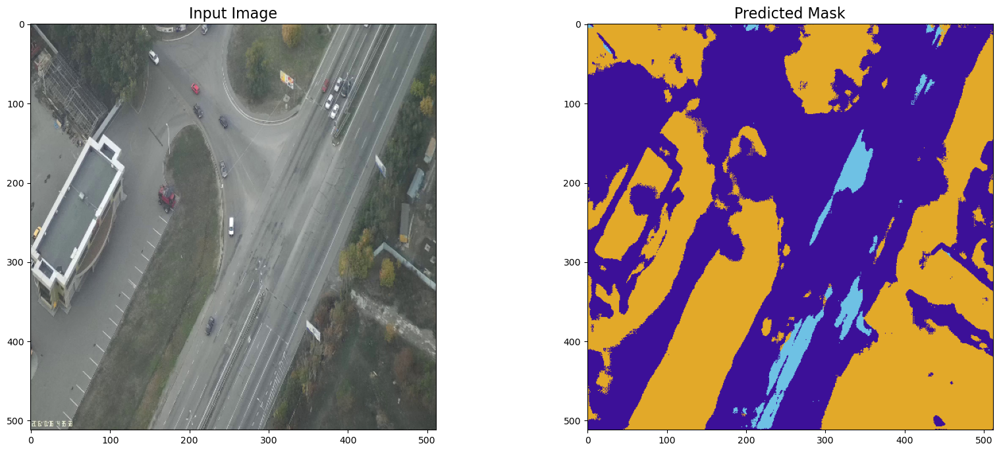

1/1 [==============================] - 0s 25ms/step


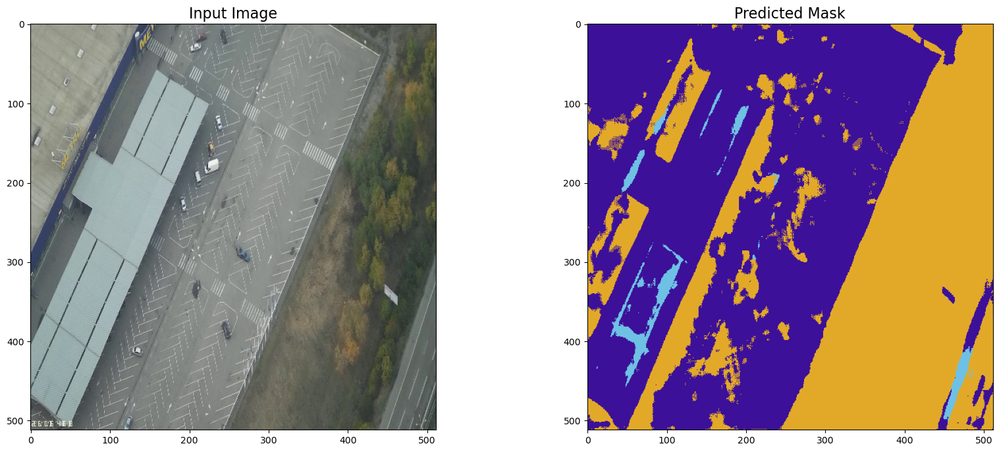

1/1 [==============================] - 0s 24ms/step


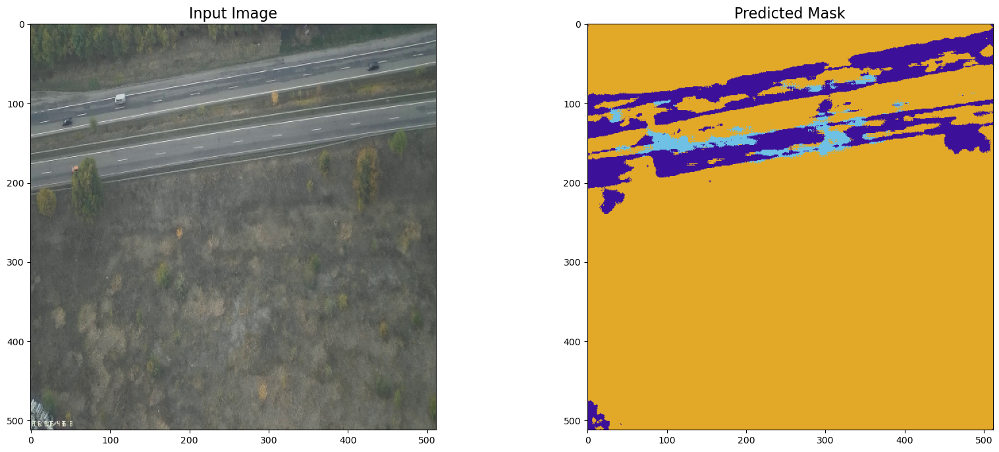

1/1 [==============================] - 0s 28ms/step


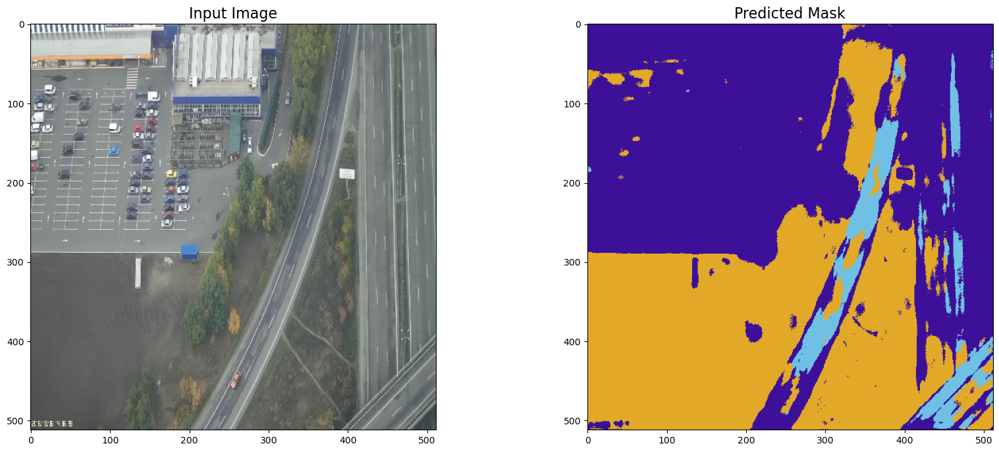

1/1 [==============================] - 0s 27ms/step


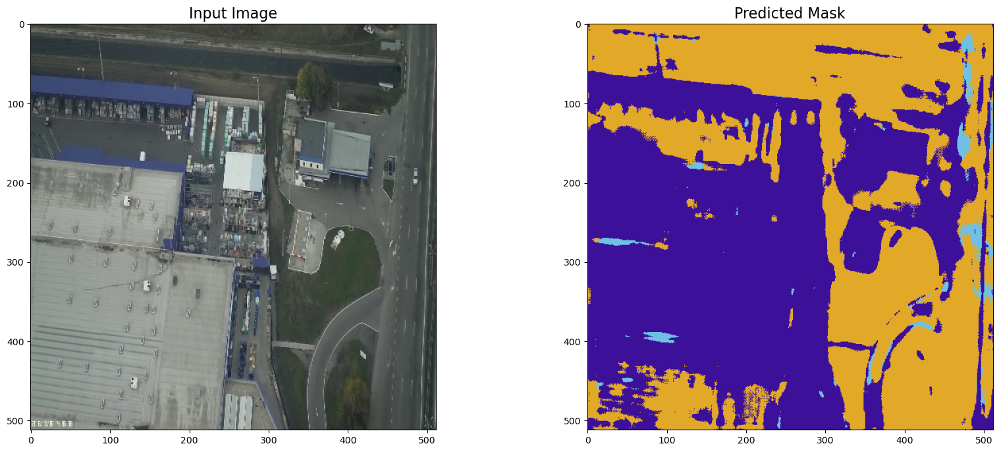

1/1 [==============================] - 0s 24ms/step


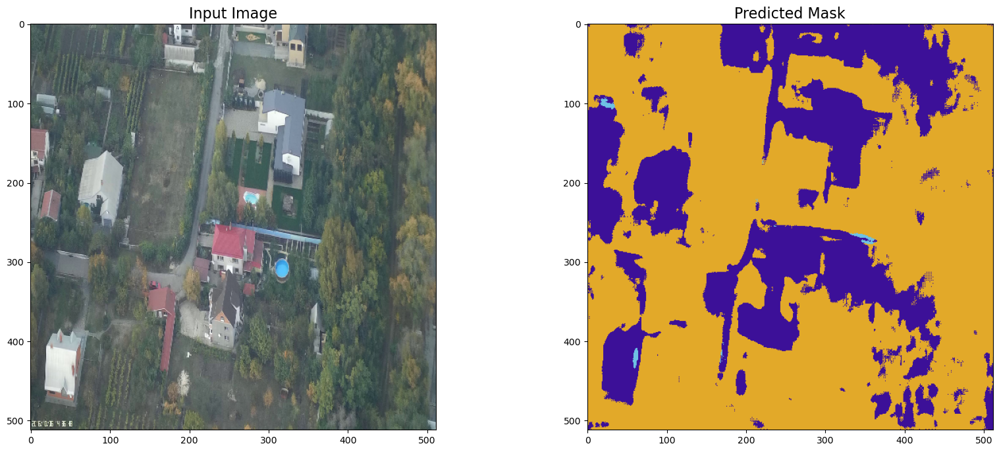

1/1 [==============================] - 0s 37ms/step


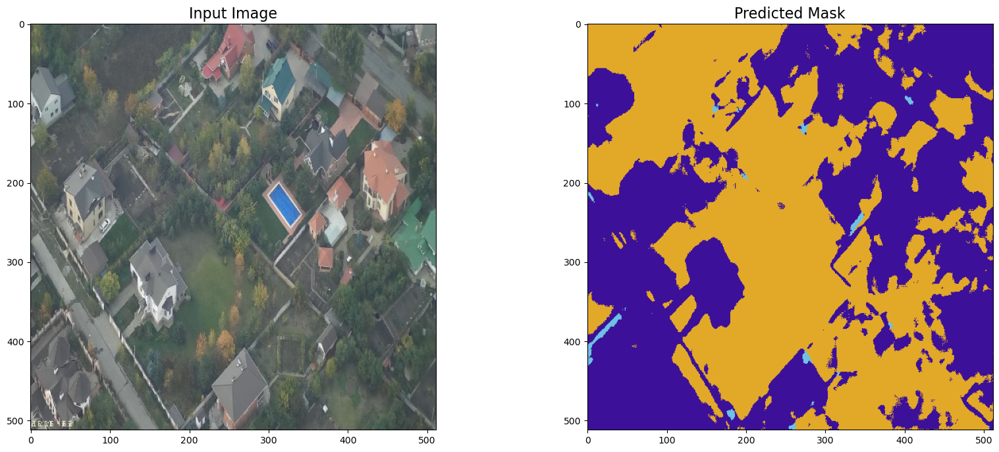

In [12]:
for file in sorted(os.listdir('./test_images')):
    
    try:
        img = cv2.imread('./test_images/' + file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (512, 512))
        img = img/255
        img = img.reshape([1,512,512,3])#.astype('float32')

        pred = model.predict(img)

        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,2,1)
        ax1.imshow(img[0])
        ax1.set_title('Input Image', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax3 = fig.add_subplot(1,2,2)
        ax3.set_title('Predicted Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred[0],id2code))
        ax3.grid(False)

        plt.show()
    except:
        print(file)